<a href="https://colab.research.google.com/github/yohanesnuwara/PalmCV/blob/main/palm_yolo_model_evaluation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.patches as mpl
import cv2
from google.colab.patches import cv2_imshow
%config InlineBackend.figure_format = 'retina'

## Load files from Drive and Set up Working Directory

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Copy folder from Drive to Colab directory, takes 30 seconds
!cp -r /content/drive/MyDrive/uav_palm_data/train2017 /content
!cp -r /content/drive/MyDrive/uav_palm_data/val2017 /content

# Unzip image folders
!unzip -q /content/train2017/train2017.zip -d /content/train2017/ 
!unzip -q /content/val2017/val2017.zip -d /content/val2017/

# Create folder structure
!mkdir /content/train
!mkdir /content/test
!mkdir /content/train/images
!mkdir /content/train/labels
!mkdir /content/test/images
!mkdir /content/test/labels

# Move train2017 and val2017 from Drive to Colab folders
!mv /content/train2017/train2017/*.jpg /content/train/images/
!mv /content/val2017/val2017/*.jpg /content/test/images/

In [ ]:
!git clone https://github.com/ultralytics/JSON2YOLO

Cloning into 'JSON2YOLO'...
remote: Enumerating objects: 262, done.
remote: Counting objects: 100% (98/98), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 262 (delta 92), reused 79 (delta 79), pack-reused 164
Receiving objects: 100% (262/262), 69.61 KiB | 17.40 MiB/s, done.
Resolving deltas: 100% (167/167), done.


In [ ]:
import sys
sys.path.append('/content/JSON2YOLO')
from general_json2yolo import convert_coco_json

In [ ]:
# Convert train2017.json to txt files
convert_coco_json('/content/train2017')

# Move txt files to labels folders
!mv /content/new_dir/labels/train2017/*.txt /content/train/labels
!rm -rf /content/new_dir

# Convert val2017.json to txt files
convert_coco_json('/content/val2017')

# Move txt files to labels folders
!mv /content/new_dir/labels/val2017/*.txt /content/test/labels
!rm -rf /content/new_dir

Annotations /content/train2017/instances_train2017.json: 100%|██████████| 262811/262811 [00:17<00:00, 14861.43it/s]
Annotations /content/val2017/instances_val2017.json: 100%|██████████| 32846/32846 [00:02<00:00, 14043.69it/s]


In [ ]:
!unzip -q '/content/drive/MyDrive/uav_palm_data/results/YOLO_result_palm (1).zip'

In [ ]:
!unzip -q '/content/drive/MyDrive/uav_palm_data/results/runs_ieee_yolo.zip'

/content/test/labels/44000_4000_2782_2398.txt: [0. 1. 3. 4.]


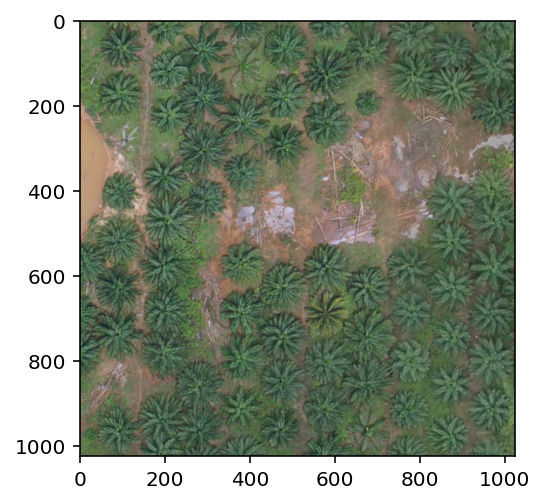

/content/test/labels/52000_20000_2021_3646.txt: [0. 1. 3. 4.]


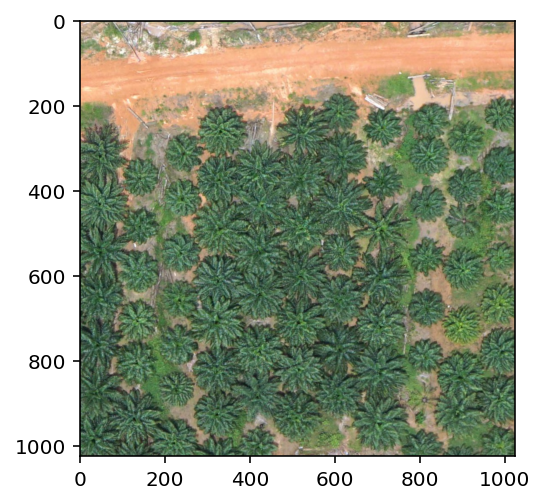

/content/test/labels/52000_20000_300_3191.txt: [1. 2. 3. 4.]


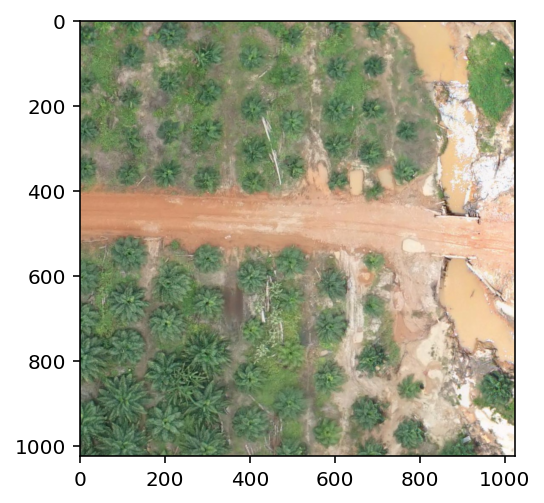

/content/test/labels/52000_20000_676_3664.txt: [0. 1. 2. 3. 4.]


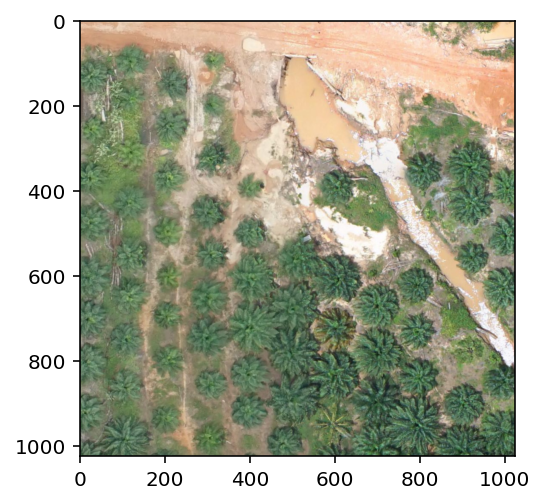

/content/test/labels/52000_20000_339_3168.txt: [1. 2. 3. 4.]


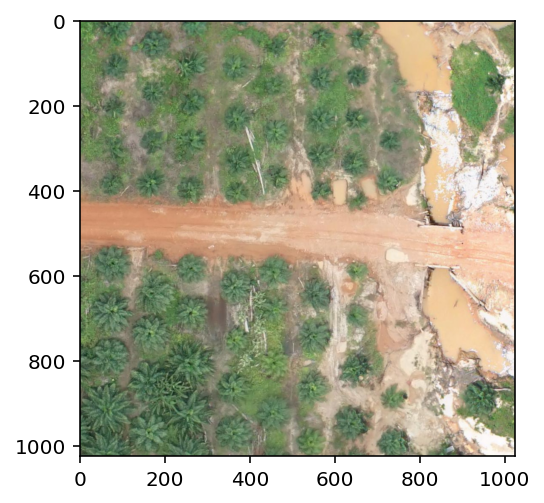

/content/test/labels/52000_20000_375_3729.txt: [1. 2. 3. 4.]


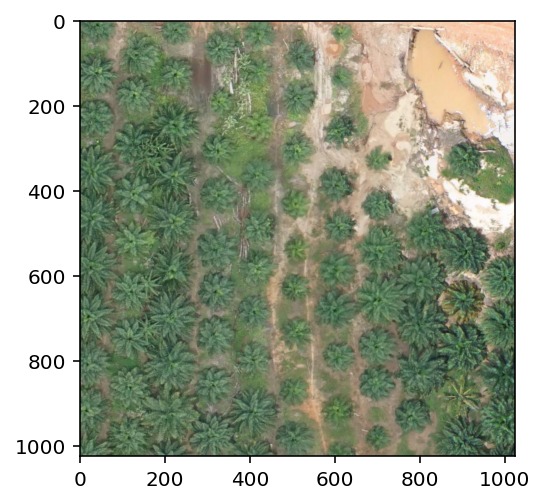

/content/test/labels/44000_4000_2616_2145.txt: [0. 1. 3. 4.]


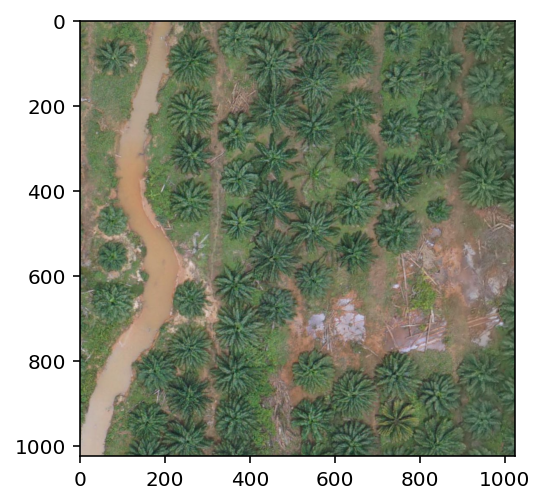

/content/test/labels/52000_20000_966_3614.txt: [0. 1. 3. 4.]


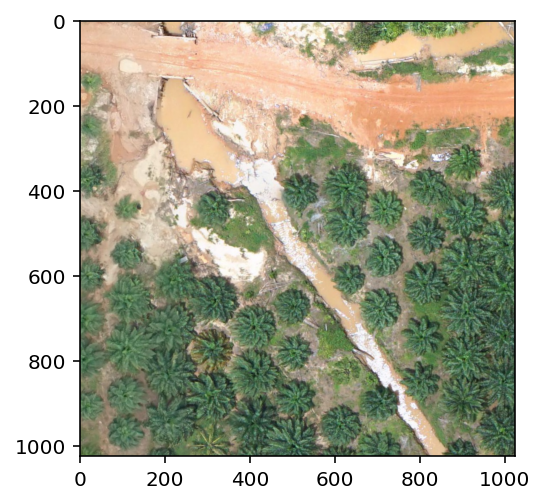

/content/test/labels/52000_20000_831_3486.txt: [0. 1. 3. 4.]


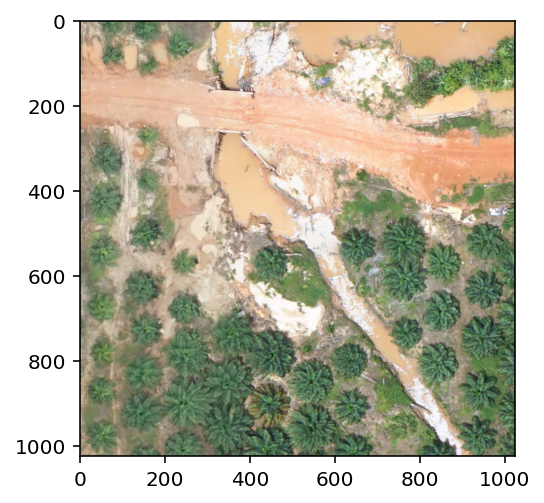

/content/test/labels/44000_16000_261_2302.txt: [1. 2. 3. 4.]


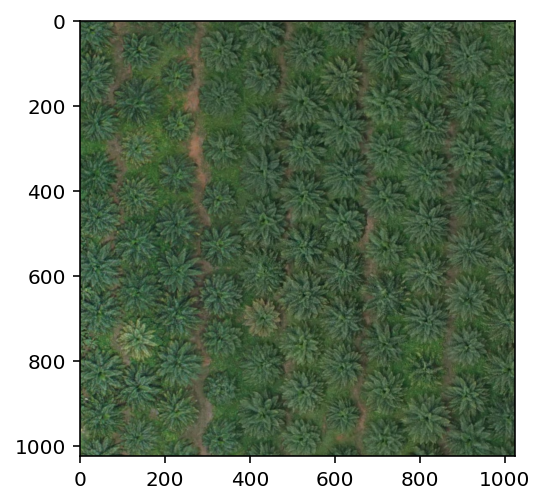

/content/test/labels/52000_20000_787_3885.txt: [0. 1. 2. 3. 4.]


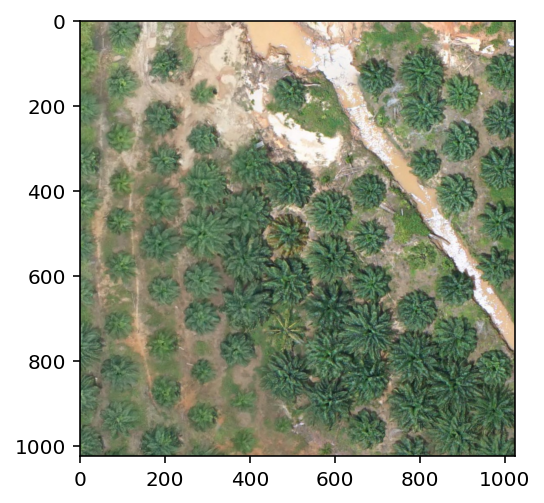

/content/test/labels/44000_4000_2390_2946.txt: [0. 1. 3. 4.]


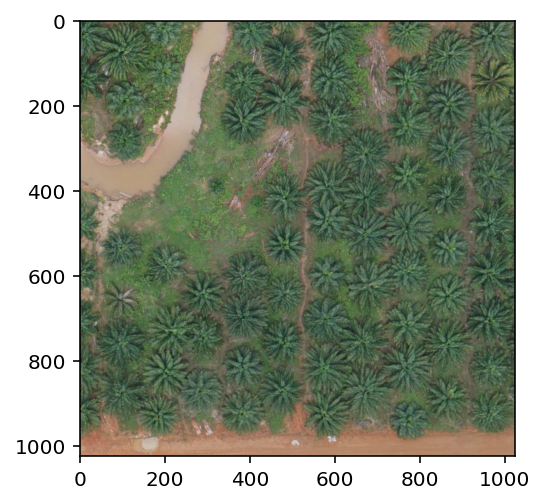

/content/test/labels/44000_4000_1536_3020.txt: [0. 1. 3. 4.]


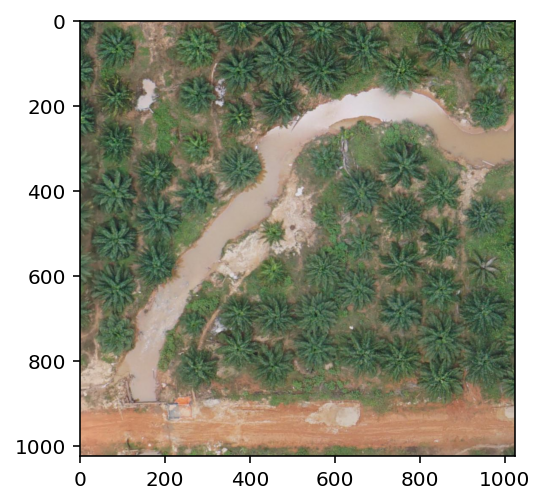

no label
/content/test/labels/52000_20000_1048_3763.txt: [0. 1. 2. 3. 4.]


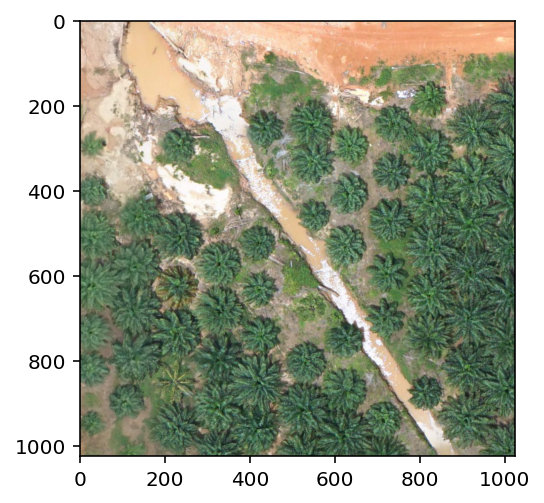

/content/test/labels/52000_20000_488_3199.txt: [1. 2. 3. 4.]


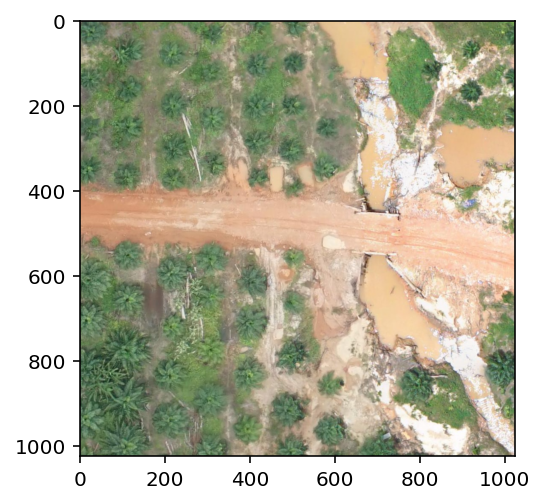

/content/test/labels/44000_16000_191_2091.txt: [1. 2. 3. 4.]


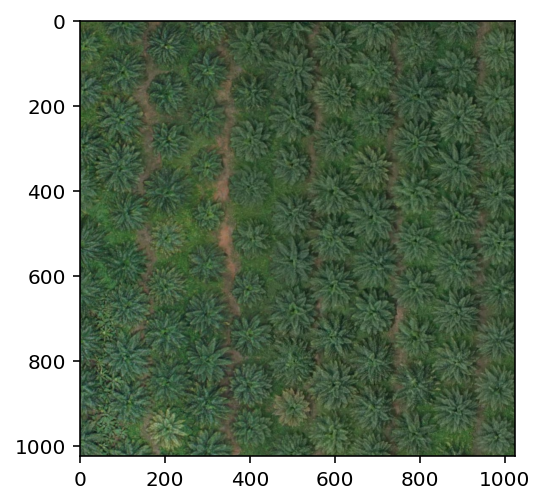

/content/test/labels/52000_20000_564_1813.txt: [1. 2. 3. 4.]


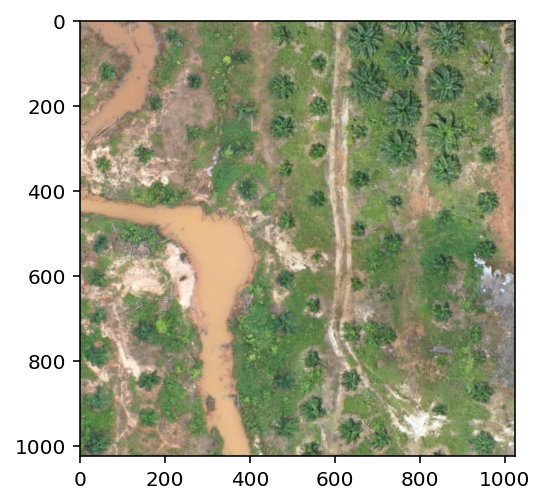

/content/test/labels/52000_20000_897_3724.txt: [0. 1. 2. 3. 4.]


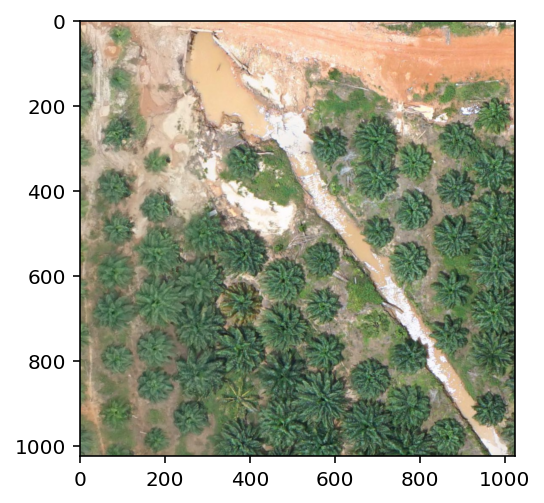

/content/test/labels/52000_20000_873_3951.txt: [0. 1. 2. 3. 4.]


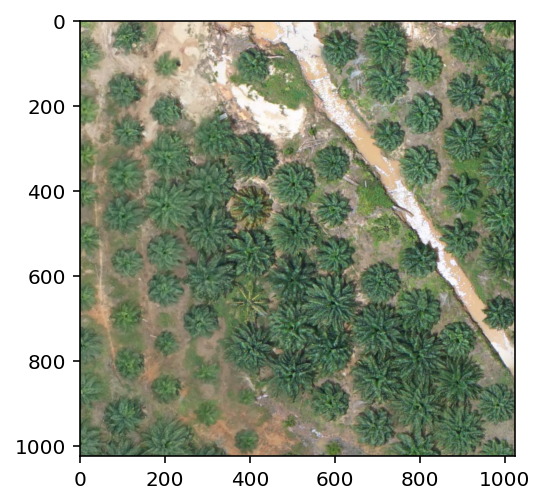

/content/test/labels/52000_20000_354_3868.txt: [1. 2. 3. 4.]


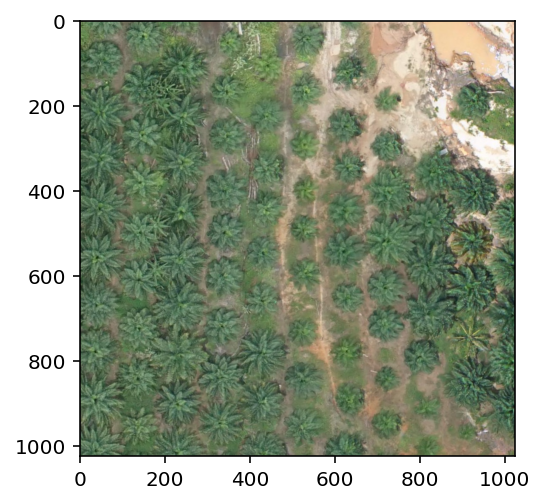

/content/test/labels/44000_4000_2624_2136.txt: [0. 1. 3. 4.]


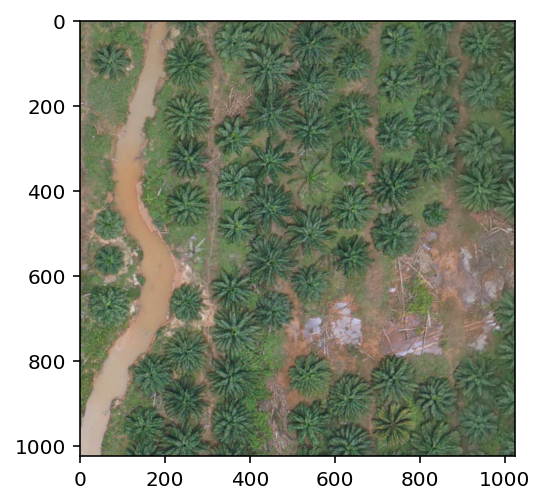

/content/test/labels/44000_4000_2995_2079.txt: [0. 1. 3. 4.]


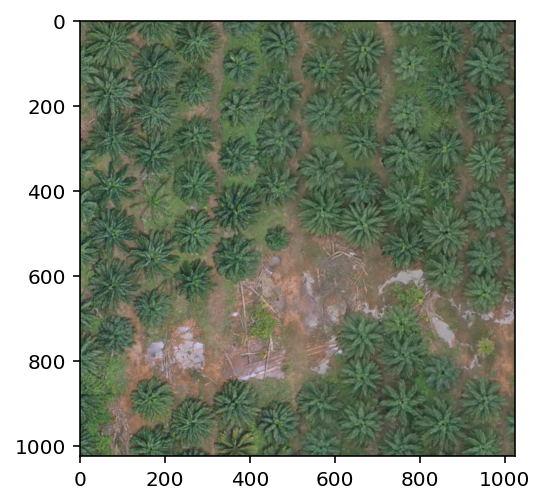

/content/test/labels/44000_4000_2393_2825.txt: [0. 1. 3. 4.]


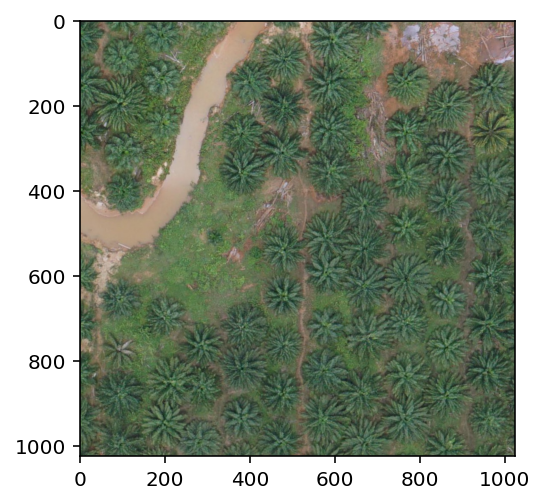

/content/test/labels/44000_4000_1937_3232.txt: [0. 1. 3. 4.]


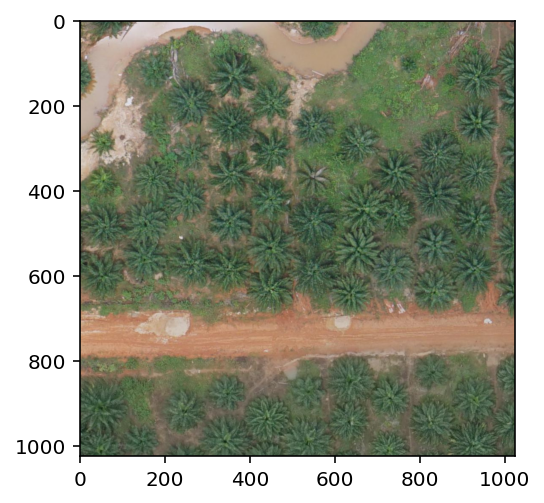

/content/test/labels/52000_20000_573_1406.txt: [1. 2. 3. 4.]


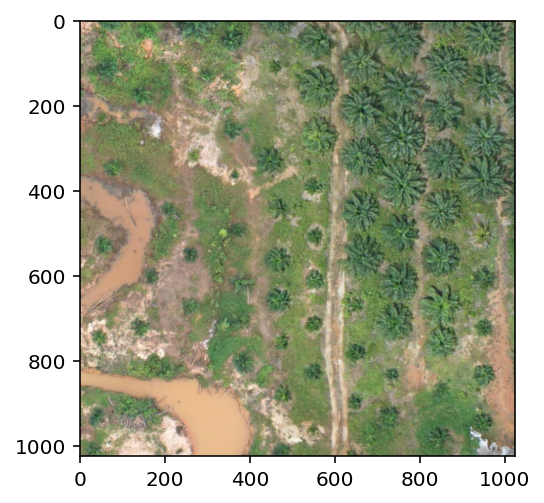

/content/test/labels/52000_20000_2269_3734.txt: [0. 1. 3. 4.]


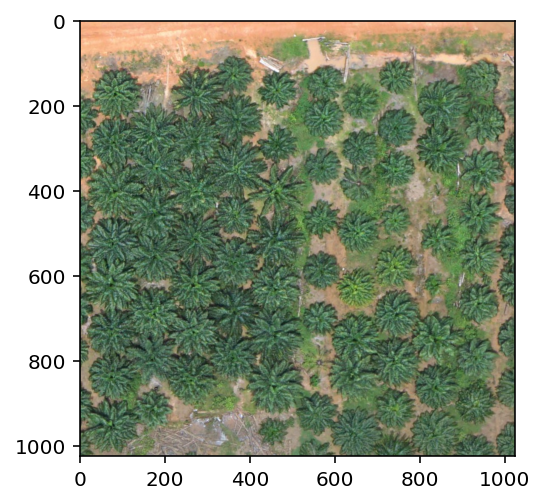

/content/test/labels/52000_20000_202_477.txt: [1. 2. 3. 4.]


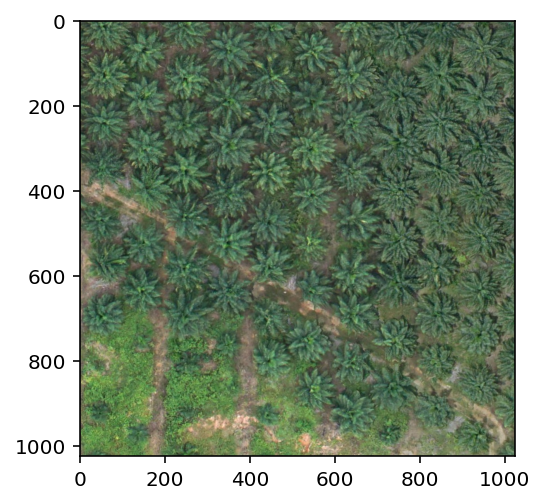

/content/test/labels/44000_4000_1850_2740.txt: [0. 1. 3. 4.]


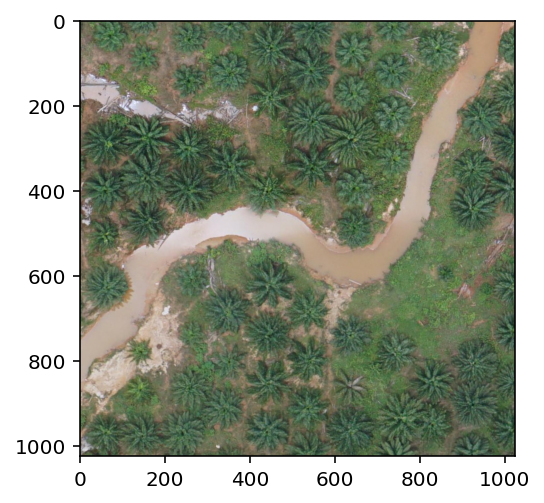

/content/test/labels/52000_20000_639_3814.txt: [0. 1. 2. 3. 4.]


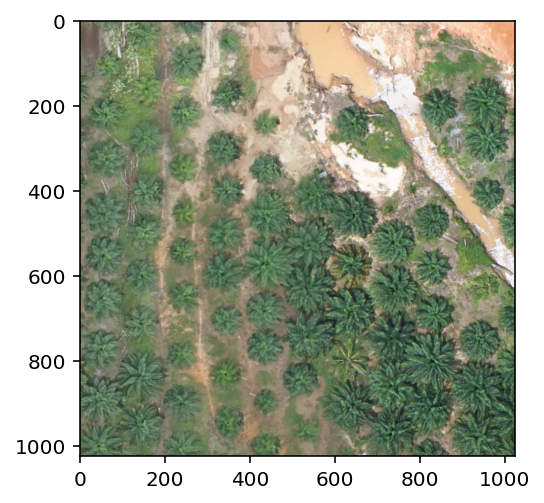

/content/test/labels/44000_4000_1906_3436.txt: [0. 1. 3. 4.]


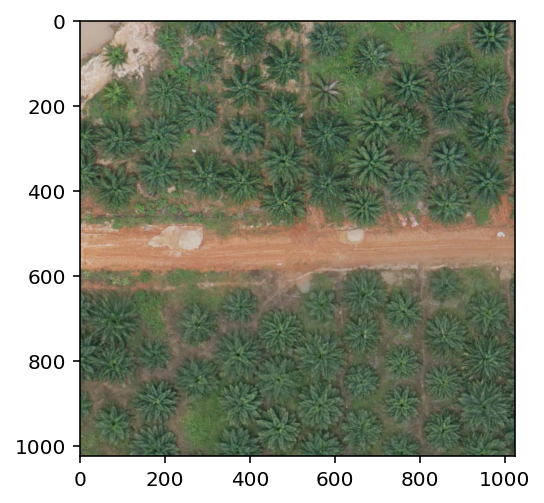

/content/test/labels/52000_20000_796_3683.txt: [0. 1. 2. 3. 4.]


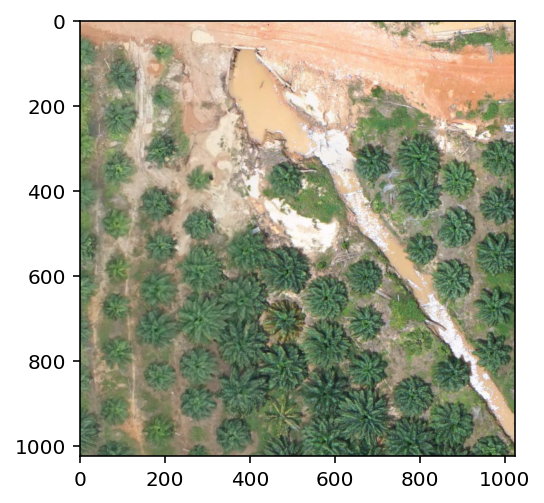

/content/test/labels/44000_16000_2163_1186.txt: [0. 1. 3. 4.]


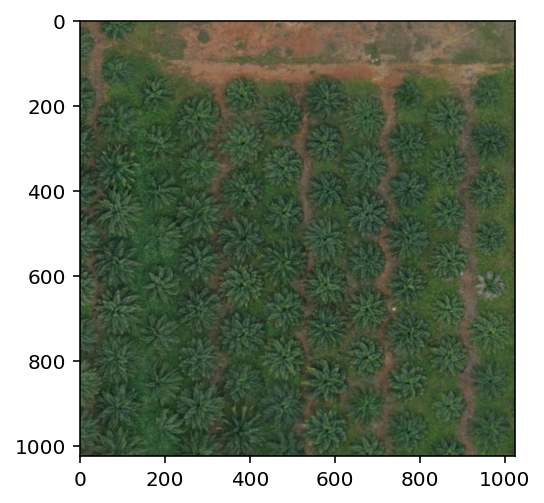

/content/test/labels/44000_4000_2428_2907.txt: [0. 1. 3. 4.]


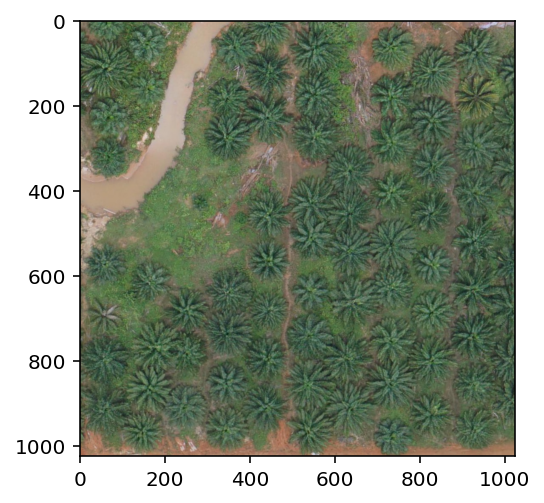

/content/test/labels/52000_20000_1020_3919.txt: [0. 1. 2. 3. 4.]


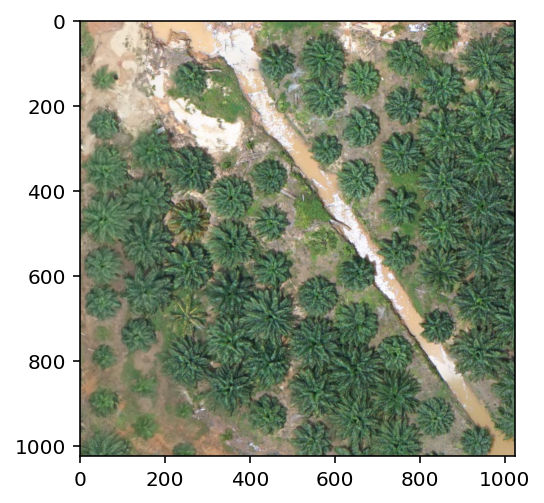

/content/test/labels/52000_20000_536_1859.txt: [1. 2. 3. 4.]


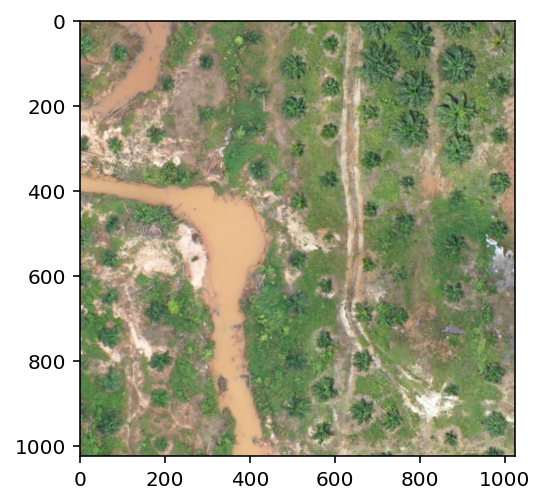

In [ ]:
for f in glob.glob('/content/test/labels/*.txt'):
  lbl = np.loadtxt(f)
  try:
    class_list = np.array(lbl[:,0])
    class_uniq = np.unique(class_list)
    if len(class_uniq)>3:
      print(f'{f}: {class_uniq}')
      img_id = f.split('/')[-1][:-4] + '.jpg'
      path = '/content/test/images/' + img_id
      img = cv2.imread(path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)      
      plt.imshow(img)
      plt.show()
  except:
    print('no label')

In [ ]:
img.shape

(1024, 1024, 3)

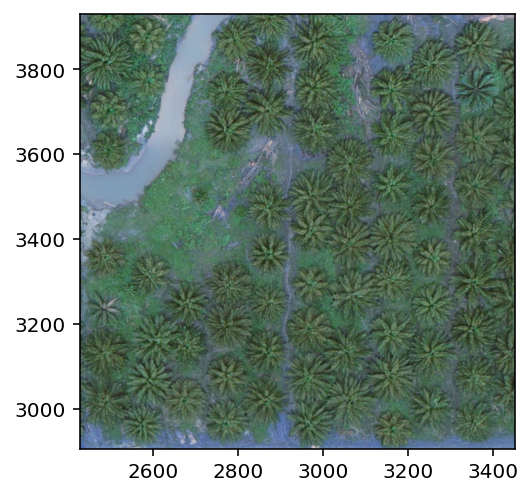

In [ ]:
img1 = cv2.imread('/content/test/images/52000_20000_1020_3919.jpg')
img2 = cv2.imread('/content/test/images/44000_4000_2428_2907.jpg')
fig, ax = plt.subplots(1,1)
# ax.imshow(img1, extent=(1020,1020+1024,3919,3919+1024))
ax.imshow(img2, extent=(2428,2428+1024,2907,2907+1024))


In [ ]:
def get_bounding_box(image, label):
  # Returns x0, y0 as bottom left coordinate and x1, y1 as top right coordinate
  img = cv2.imread(image)
  w_img, h_img, ch_img = img.shape

  lab = np.loadtxt(label)

  # Get palm class, center coordinates, width, and height from label data
  pclass, xc, yc, w, h = lab[:,0], lab[:,1], lab[:,2], lab[:,3], lab[:,4]

  # Calculate center coordinates in pixels
  x_lab, y_lab = xc * w_img, yc * h_img

  # Calculate width and height of label in pixels: w relative, h_relative, y, h
  w_lab, h_lab = w * w_img, h * h_img

  # Calculate offset
  x_ofset, y_ofset = w_lab / 2, h_lab / 2

  # Calculate x0, y0
  x0, y0 = (x_lab - x_ofset).astype(int), (y_lab - y_ofset).astype(int)

  # Calculate x1, y1
  x1, y1 = (x0 + w_lab).astype(int), (y0 + h_lab).astype(int)  
  return pclass, x0, y0, x1, y1

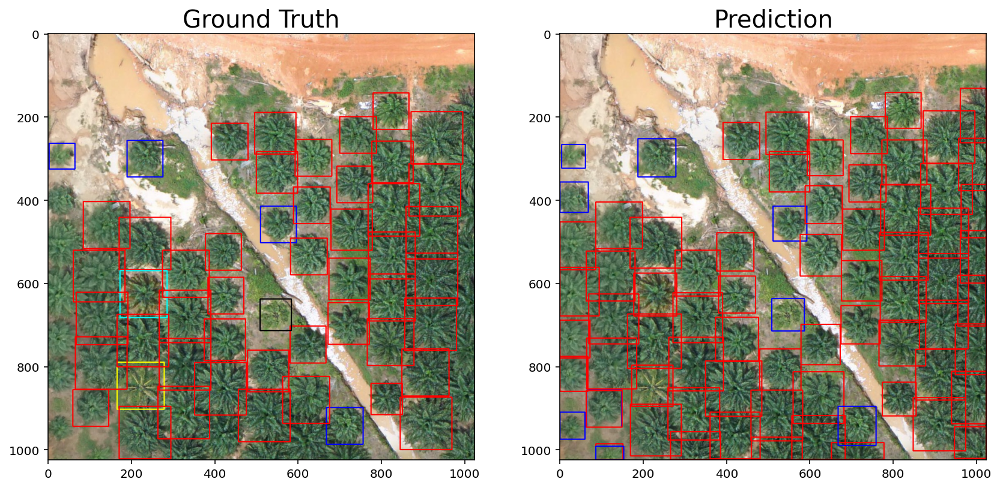

In [ ]:
id = '52000_20000_1048_3763'

image = '/content/test/images/' + id + '.jpg'
label = '/content/test/labels/' + id + '.txt'
pred = '/content/content/yolov5/runs/detect/exp/labels/' + id + '.txt'

# Get bounding box coordinates (groundtruth)
pclass, x0, y0, x1, y1 = get_bounding_box(image, label)

# Get bounding box coordinates (detection)
pclass_pred, x0_pred, y0_pred, x1_pred, y1_pred = get_bounding_box(image, pred) 

plt.figure(figsize=(14,14))

# Plot 1: Ground truth
plt.subplot(1,2,1)
img = cv2.imread(image)

for i in range(len(x0)):
  a, b = x0[i], y0[i]
  c, d = x1[i], y1[i]
  # Color code
  if pclass[i].astype(int) == 0:
    color = (0,0,0) # black
  if pclass[i].astype(int) == 1:
    color = (0,0,255) # red
  if pclass[i].astype(int) == 2:
    color = (0,255,255) # yellow
  if pclass[i].astype(int) == 3:
    color = (255,0,0) # blue
  if pclass[i].astype(int) == 4:
    color = (255,255,0) # cyan

  # Plot bounding box
  thickness = 2
  f = cv2.rectangle(img, (a,b), (c,d), color, thickness)
  f = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
  
  # Plot image
  plt.imshow(f)
  plt.title('Ground Truth', size=20)

# Plot 2: Detection
plt.subplot(1,2,2)
img = cv2.imread(image)

for i in range(len(x0_pred)):
  a, b = x0_pred[i], y0_pred[i]
  c, d = x1_pred[i], y1_pred[i]
  # Color code
  if pclass_pred[i].astype(int) == 0:
    color = (0,0,0) # black
  if pclass_pred[i].astype(int) == 1:
    color = (0,0,255) # red
  if pclass_pred[i].astype(int) == 2:
    color = (0,255,255) # yellow
  if pclass_pred[i].astype(int) == 3:
    color = (255,0,0) # blue
  if pclass_pred[i].astype(int) == 4:
    color = (255,255,0) # cyan

  # Plot bounding box
  # color = (0,255,255)
  thickness = 2
  h = cv2.rectangle(img, (a,b), (c,d), color, thickness)
  h = cv2.cvtColor(h, cv2.COLOR_BGR2RGB)
  
  # Plot image
  plt.imshow(h)  
  plt.title('Prediction', size=20)

plt.show()

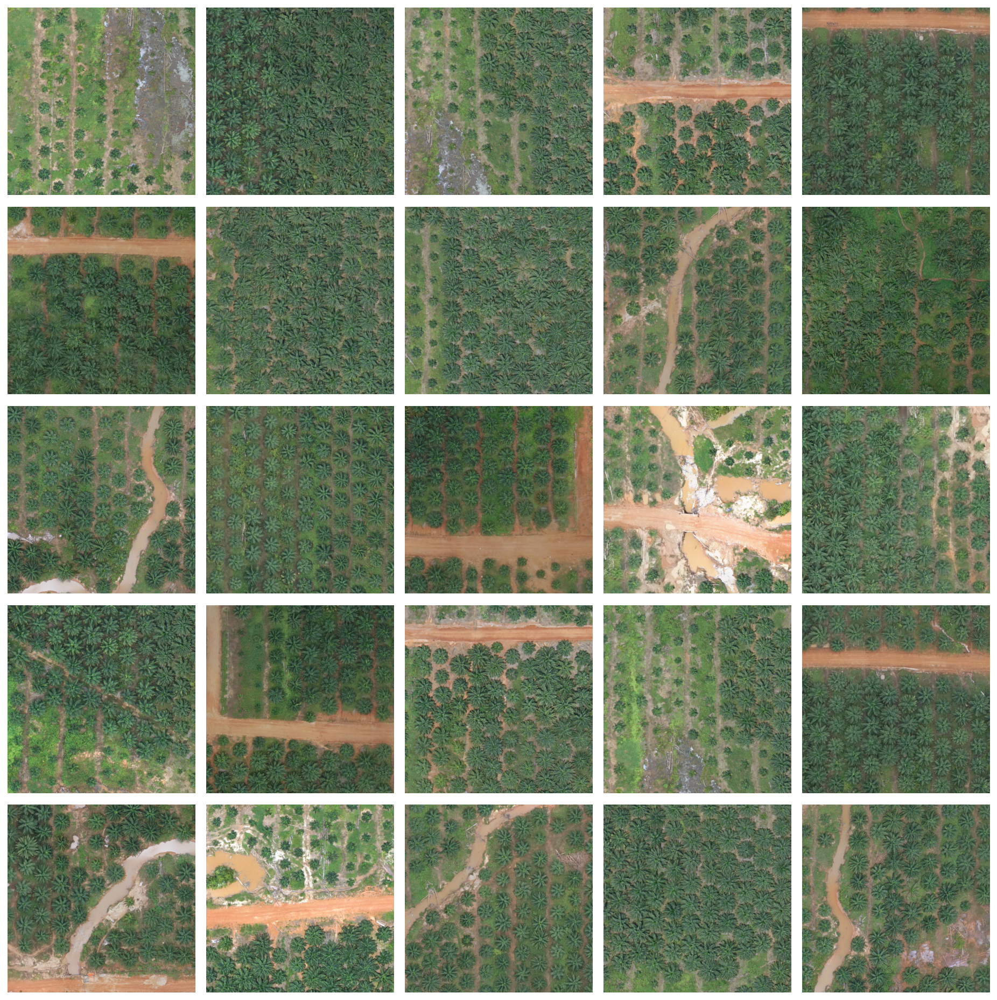

In [ ]:
list_images = []
for f in glob.glob('/content/test/images/*.jpg'):
  list_images.append(f)

images_25 = list_images[:25]

plt.figure(figsize=(13,13))
for i in range(len(images_25)):
  plt.subplot(5,5,i+1)
  img = cv2.imread(images_25[i])
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  plt.imshow(img)
  plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
from yolov5 import utils

Cloning into 'yolov5'...
remote: Enumerating objects: 12173, done.
remote: Total 12173 (delta 0), reused 0 (delta 0), pack-reused 12173
Receiving objects: 100% (12173/12173), 11.90 MiB | 7.27 MiB/s, done.
Resolving deltas: 100% (8429/8429), done.
/content/yolov5
     |████████████████████████████████| 596 kB 8.1 MB/s 


## Separate training file into train and validation set

In [ ]:
list_image = []
for f in glob.glob('/content/train/labels/*'):
  list_image.append(f)

In [ ]:
from sklearn.model_selection import train_test_split

train, val = train_test_split(list_image, test_size=0.3, random_state=11)

In [ ]:
!mkdir /content/uav_palm_data
!mkdir /content/uav_palm_data/images
!mkdir /content/uav_palm_data/images/train
!mkdir /content/uav_palm_data/images/val
!mkdir /content/uav_palm_data/labels
!mkdir /content/uav_palm_data/labels/train
!mkdir /content/uav_palm_data/labels/val

In [ ]:
image_dest = '/content/uav_palm_data/images/train'
label_dest = '/content/uav_palm_data/labels/train'

for t in train:
  fileid = t.split('/')[-1][:-4]
  image_name = fileid + '.jpg'
  label_name = fileid + '.txt'
  image_src = '/content/train/images/' + image_name
  label_src = '/content/train/labels/' + label_name
  os.system(f'mv {image_src} {image_dest}')
  os.system(f'mv {label_src} {label_dest}')


In [ ]:
image_dest = '/content/uav_palm_data/images/val'
label_dest = '/content/uav_palm_data/labels/val'

for v in val:
  fileid = v.split('/')[-1][:-4]
  image_name = fileid + '.jpg'
  label_name = fileid + '.txt'
  image_src = '/content/train/images/' + image_name
  label_src = '/content/train/labels/' + label_name
  os.system(f'mv {image_src} {image_dest}')
  os.system(f'mv {label_src} {label_dest}')
  

## Validation

In [ ]:
%%writefile /content/palm_validation.yaml
# YOLOv5 🚀 by Ultralytics, GPL-3.0 license
# COCO128 dataset https://www.kaggle.com/ultralytics/coco128 (first 128 images from COCO train2017) by Ultralytics
# Example usage: python train.py --data coco128.yaml
# parent
# ├── yolov5
# └── datasets
#     └── coco128  ← downloads here (7 MB)


# Train/val/test sets as 1) dir: path/to/imgs, 2) file: path/to/imgs.txt, or 3) list: [path/to/imgs1, path/to/imgs2, ..]
path: /content/ # dataset root dir
train: uav_palm_data/images/train  # train images (relative to 'path') 128 images
val: uav_palm_data/images/val  # val images (relative to 'path') 128 images
test: test/images # test images (optional)
# test: content/yolov5/runs/detect/exp # test images (optional)

# Classes
nc: 5  # number of classes
names: ["palm1", "palm2", "palm3", "palm4", "palm5"]  # class names

Overwriting /content/palm_validation.yaml


In [ ]:
!python val.py --data /content/palm_validation.yaml --weights /content/content/yolov5/runs/train/exp/weights/best.pt --task test

val: data=/content/palm_validation.yaml, weights=['/content/content/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-244-g47233e1 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/test/labels.cache' images and labels... 500 found, 0 missing, 0 empty, 0 corrupt: 100% 500/500 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 16/16 [00:35<00:00,  2.24s/it]
                 all        500      32846       0.99      0.392      0.434      0.368
               palm1        500         61          1          0     0.0344     0.0298
    

In [ ]:
!zip -r '/content/YOLO_eval_palm.zip' '/content/yolov5/runs/val/exp6'

  adding: content/yolov5/runs/val/exp6/ (stored 0%)
  adding: content/yolov5/runs/val/exp6/R_curve.png (deflated 13%)
  adding: content/yolov5/runs/val/exp6/val_batch0_pred.jpg (deflated 2%)
  adding: content/yolov5/runs/val/exp6/val_batch2_pred.jpg (deflated 2%)
  adding: content/yolov5/runs/val/exp6/val_batch0_labels.jpg (deflated 2%)
  adding: content/yolov5/runs/val/exp6/val_batch1_labels.jpg (deflated 3%)
  adding: content/yolov5/runs/val/exp6/PR_curve.png (deflated 13%)
  adding: content/yolov5/runs/val/exp6/F1_curve.png (deflated 11%)
  adding: content/yolov5/runs/val/exp6/val_batch2_labels.jpg (deflated 3%)
  adding: content/yolov5/runs/val/exp6/confusion_matrix.png (deflated 28%)
  adding: content/yolov5/runs/val/exp6/val_batch1_pred.jpg (deflated 2%)
  adding: content/yolov5/runs/val/exp6/P_curve.png (deflated 13%)
